In [2]:
%matplotlib inline

In [3]:
import LFPy
import numpy as np
import matplotlib.pyplot as plt

In [4]:
# Define cell parameters
cell_parameters = {          # various cell parameters,
    'morphology' : 'morphologies/L5_Mainen96_LFPy.hoc', # Mainen&Sejnowski, 1996
    'cm' : 1.0,         # membrane capacitance
    'Ra' : 150.,        # axial resistance
    'v_init' : -65.,    # initial crossmembrane potential
    'passive' : True,   # turn on passive mechanism for all sections
    'passive_parameters' : {'g_pas' : 1./30000, 'e_pas' : -65}, # passive params
    'nsegs_method' : 'lambda_f', # lambda_f method
    'lambda_f' : 100.,  # lambda_f critical frequency
    'dt' : 2.**-3,      # simulation time step size
    'tstart' : 0.,      # start time of simulation, recorders start at t=0
    'tstop' : 100.,     # stop simulation at 200 ms. These can be overridden
                        # by setting these arguments in cell.simulation()
}

# Create cell
cell = LFPy.Cell(**cell_parameters)

# Define synapse parameters
#synapse = LFPy.Synapse(cell, 
#                       idx = cell.get_closest_idx(x=0., y=0., z=900.),
#                       syntype = 'Exp2Syn', 
#                       weight = 0.005, 
#                       e = 0, 
#                       tau1 = 0.5,
#                       tau2 = 2,
#                       record_current = True)

synapse_parameters = {
    'idx' : cell.get_closest_idx(x=0., y=0., z=900.),
    'e' : 0.,                   # reversal potential
    'syntype' : 'Exp2Syn',       # synapse type
    'tau1' : 0.5,
    'tau2' : 2.,
    'weight' : 0.005,            # syn. weight
    'record_current' : True,
}

#synapse_parameters = {
#    'idx' : cell.get_closest_idx(x=0., y=0., z=900.),
#    'e' : 0.,                   # reversal potential
#    'syntype' : 'ExpSyn',       # synapse type
#    'tau' : 10.,                # syn. time constant
#    'weight' : .001,            # syn. weight
#    'record_current' : True,
#}

# Create synapse and set time of synaptic input
synapse = LFPy.Synapse(cell, **synapse_parameters)
synapse.set_spike_times(np.array([10., 30., 50., 70.]))

#synapse.set_spike_times_w_netstim(noise=1.0, start=0.0, number=1000.0, interval=10.0, seed=1234.0)

# Create a grid of measurement locations, in (mum)
#X, Z = np.mgrid[-500:501:20, -400:1201:40]
#Y = np.zeros(X.shape)
X, Y, Z = np.mgrid[-500:501:20, -500:501:20, -400:1201:40]

# Define electrode parameters
electrode_parameters = {
    'sigma' : 0.3,      # extracellular conductivity
    'x' : X.flatten(),  # electrode requires 1d vector of positions
    'y' : Y.flatten(),
    'z' : Z.flatten()
}

# Create electrode object
electrode = LFPy.RecExtElectrode(**electrode_parameters)

# Run simulation, electrode object argument in cell.simulate
cell.simulate(electrode=electrode, rec_imem=True)

In [5]:
electrode.calc_lfp()

[-500, 500, -400, 1200]

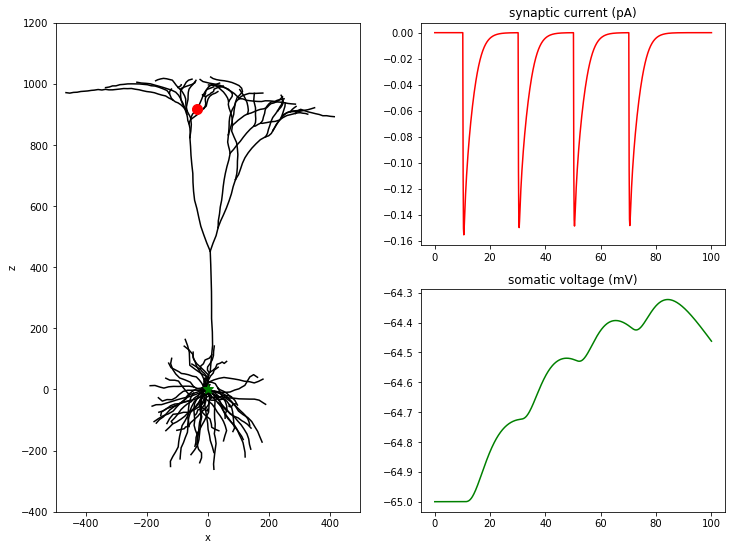

In [6]:
plt.figure(figsize=(12, 9))
plt.subplot(222)
plt.plot(cell.tvec, synapse.i, 'r'), plt.title('synaptic current (pA)')
plt.subplot(224)
plt.plot(cell.tvec, cell.somav, 'g'), plt.title('somatic voltage (mV)')
plt.subplot(121)
for sec in LFPy.cell.neuron.h.allsec():
    idx = cell.get_idx(sec.name())
    plt.plot(np.r_[cell.xstart[idx], cell.xend[idx][-1]],
            np.r_[cell.zstart[idx], cell.zend[idx][-1]],
            color='k')
plt.xlabel('x')
plt.ylabel('z')
plt.plot([cell.synapses[0].x], [cell.synapses[0].z], \
     color='r', marker='o', markersize=10)


plt.plot(0.0, 0.0, color='g', marker='*', markersize=10)

plt.axis([-500, 500, -400, 1200])

In [8]:
import scipy.io as sio
print(X.flatten().shape, electrode.LFP.shape)
sio.savemat('single_synapse.mat', {'x': X.flatten(),'y': Y.flatten(),'z': Z.flatten(),'lfp':electrode.LFP[:,0]})

#for t in list(range(0,100)):
#    mat_file='output/'+'{:0>4}'.format(str(i))+'.mat'
#    sio.savemat(mat_file, {'x': X.flatten(),'y': Y.flatten(),'z': Z.flatten(),'lfp':electrode.LFP.flatten()})

(106641,) (106641, 801)


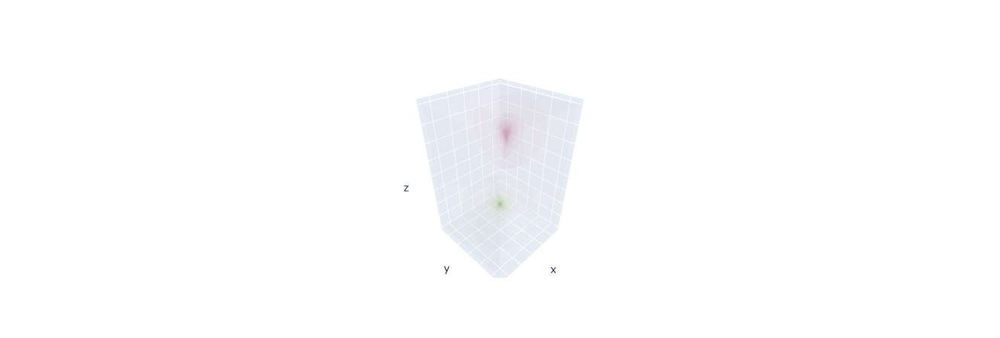

In [11]:
import plotly.graph_objects as go


limLFP = abs(electrode.LFP).max()

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value= electrode.LFP[:,200],
    isomin=np.amin(electrode.LFP[:,200]),
    isomax=np.amax(electrode.LFP[:,200]),
    showscale=False,
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=17, # needs to be a large number for good volume rendering
    ))
fig.update_layout(scene_xaxis_showticklabels=False,
                  scene_yaxis_showticklabels=False,
                  scene_zaxis_showticklabels=False)
fig.show()


## Plot simulation output:

/work/examples/example_suppl.py:64: UserWarning: No contour levels were found within the data range.
  ct2 = ax1.contour(X, Z, LFP, n_contours_black, colors='k')
/work/examples/example_suppl.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(12, 8))


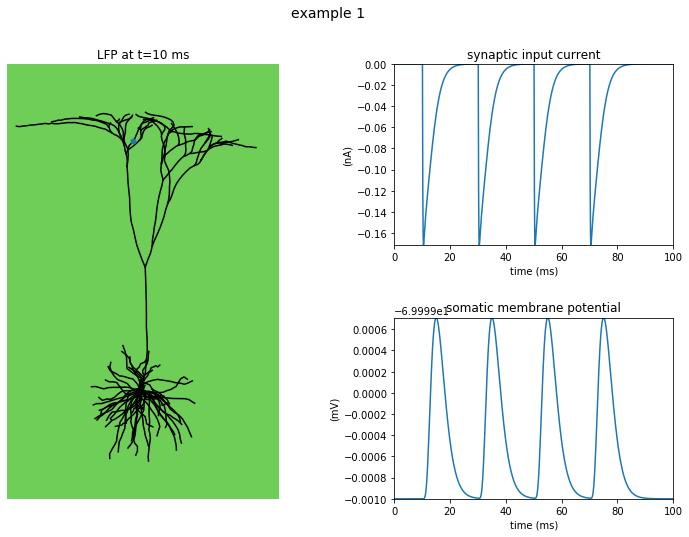

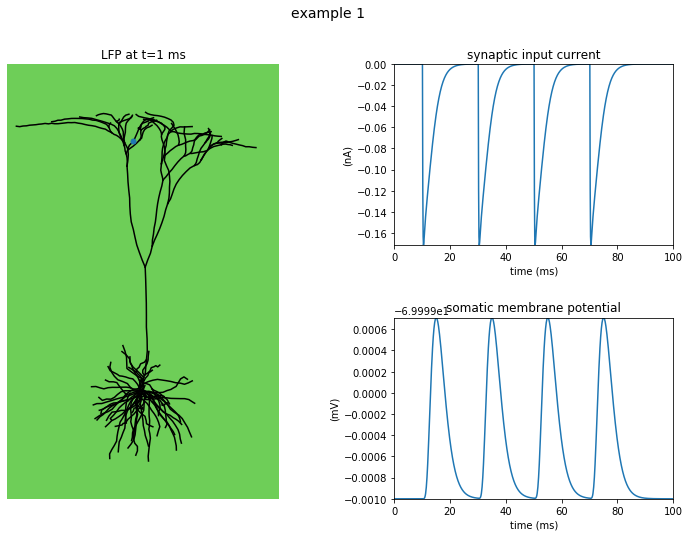

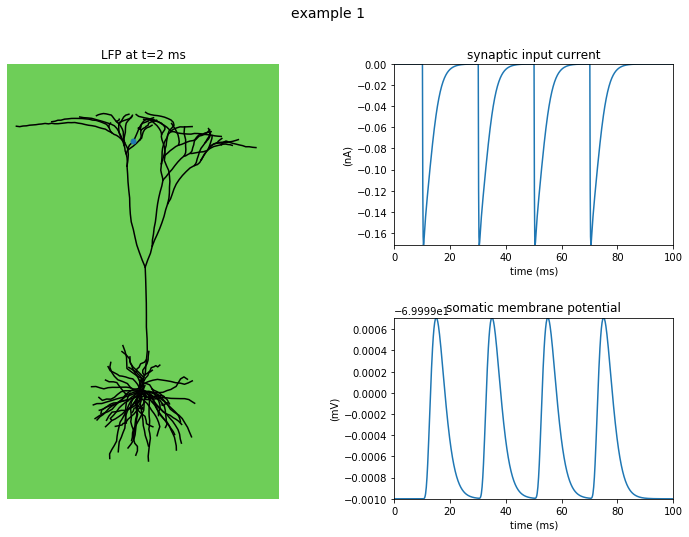

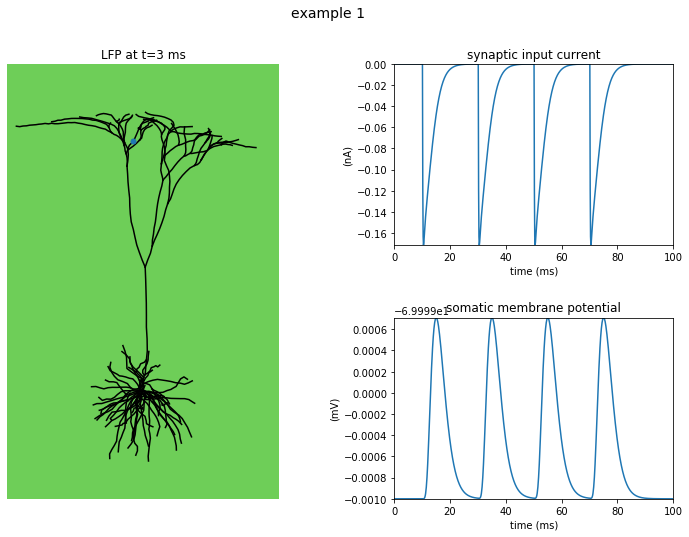

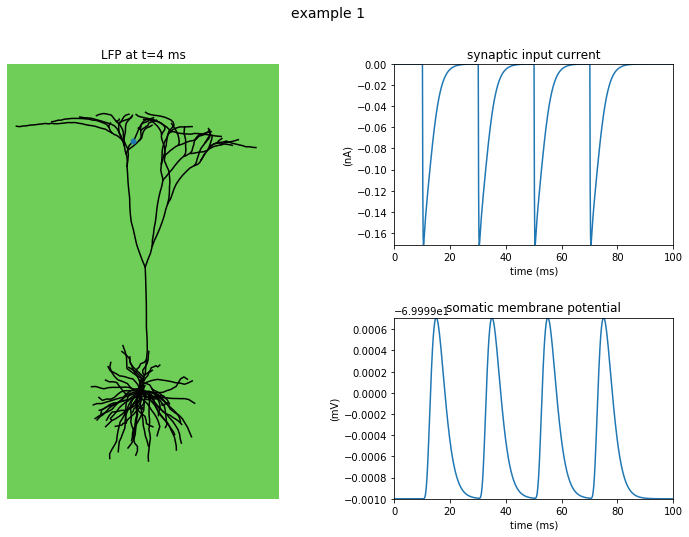

...

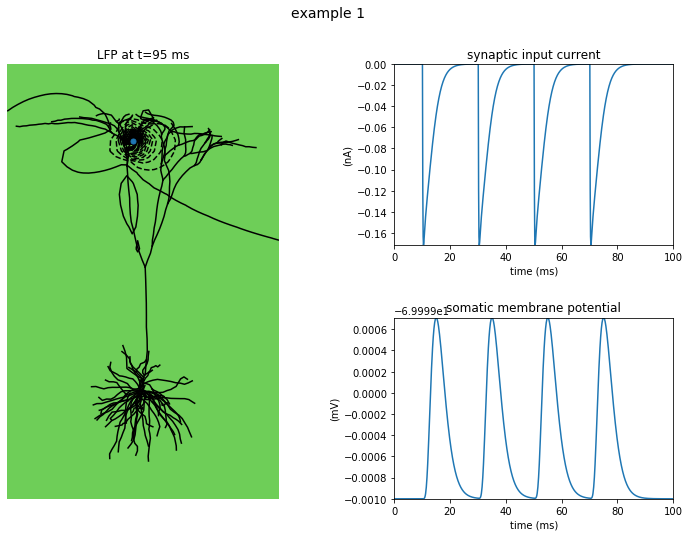

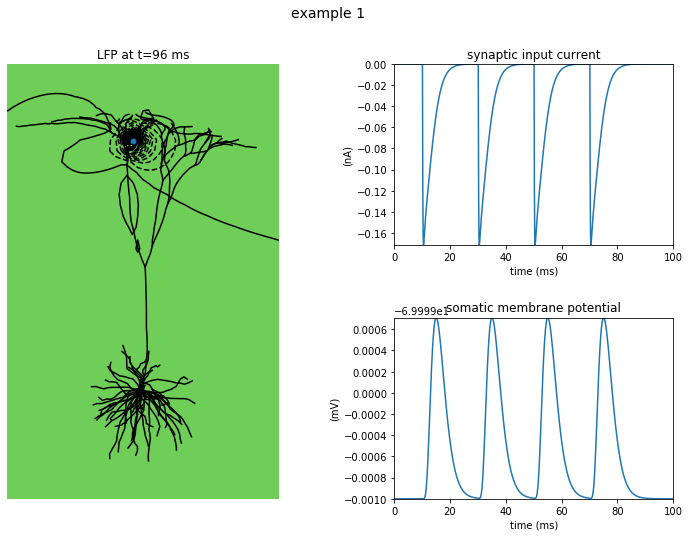

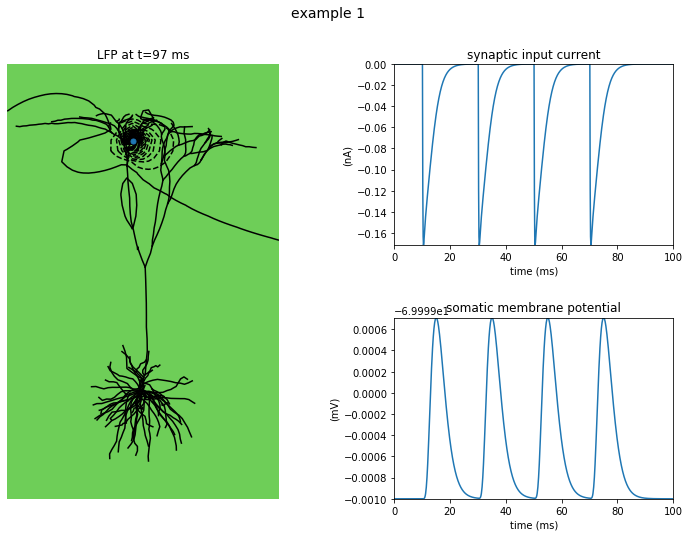

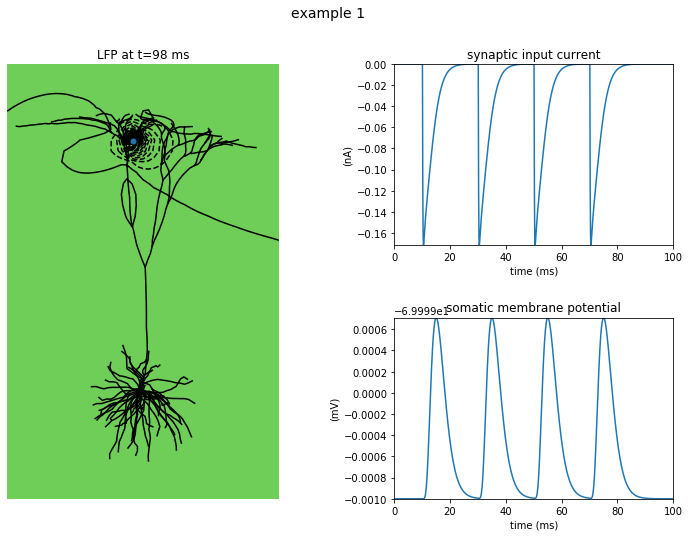

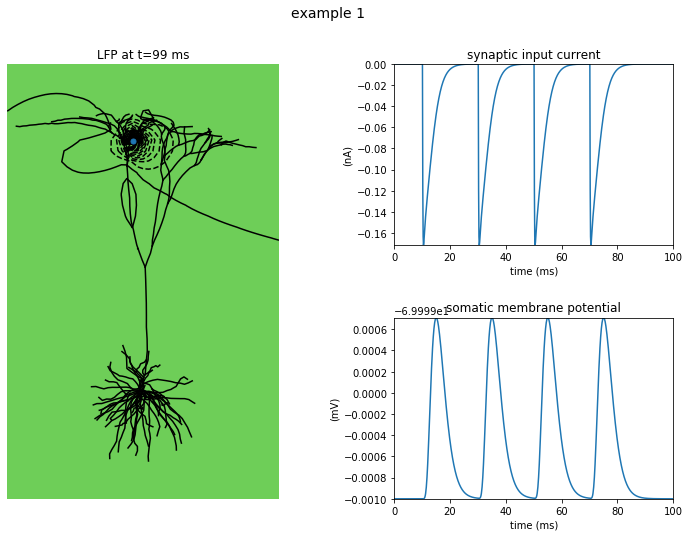

In [6]:
from example_suppl import plot_ex1
fig = plot_ex1(cell, electrode, X, Y, Z, 10)
# Optionally save figure (uncomment the line below)
#fig.savefig('LFPy-example-5.png', dpi=300)
#for i in list(range(1,100)):
    #print('{:0>4}'.format(str(i)))
#    fig = plot_ex1(cell, electrode, X, Y, Z, i)
#    fig.savefig('output/'+'{:0>4}'.format(str(i))+'.png', dpi=300)